<a href="https://colab.research.google.com/github/Vladislav-GitHub/Credit-Scoring_HSE_Bootcamp/blob/main/Homewrork_HSE_course_EDA_(exploratory_data_analysis).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Кредитный скоринг

#Описание данных
Датасет содержит информацию о клиентах некоторого банка.
Ваша задача состоит в том, чтобы по различным характеристикам клиентов спрогнозировать целевую переменную - имел клиент просрочку 90 и более дней или нет (и если имел, то банк не будет выдавать кредит этому клиенту, а иначе будет).

**Целевая переменная (таргет)** – SeriousDlqin2yrs: клиент имел просрочку 90 и более дней

**Признаки:**

*   RevolvingUtilizationOfUnsecuredLines: общий баланс средств (total balance on credit cards and personal lines of credit except real estate and no installment debt like car loans divided by the sum of credit limits)
*   age: возраст заемщика
*   NumberOfTime30-59DaysPastDueNotWorse: сколько раз за последние 2 года наблюдалась просрочка 30-59 дней
*   DebtRatio: ежемесячные расходы (платеж по долгам, алиментам, расходы на проживания) деленные на месячный доход
*   MonthlyIncome: ежемесячный доход
*   NumberOfOpenCreditLinesAndLoans: количество открытых кредитов (напрмер, автокредит или ипотека) и кредитных карт
*   NumberOfTimes90DaysLate: сколько раз наблюдалась просрочка (90 и более дней)
NumberRealEstateLoansOrLines: количество кредитов (в том числе под залог жилья)
*   RealEstateLoansOrLines: закодированное количество кредитов (в том числе под залог жилья) - чем больше код буквы, тем больше кредитов
*   NumberOfTime60-89DaysPastDueNotWorse: сколько раз за последние 2 года заемщик задержал платеж на 60-89 дней
*   NumberOfDependents: количество иждивенцев на попечении (супруги, дети и др)
*   GroupAge: закодированная возрастная группа - чем больше код, тем больше возраст



In [229]:
!pip install optuna
!pip install catboost
!sudo apt-get install git

Reading package lists... Done
Building dependency tree       
Reading state information... Done
git is already the newest version (1:2.25.1-1ubuntu3.11).
0 upgraded, 0 newly installed, 0 to remove and 13 not upgraded.


In [163]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from catboost import CatBoostClassifier, Pool
from sklearn.model_selection import cross_val_score
import warnings


warnings.filterwarnings('ignore')

In [164]:
data = pd.read_csv('https://raw.githubusercontent.com/evgpat/edu_stepik_from_idea_to_mvp/main/datasets/credit_scoring.csv')
data.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,RealEstateLoansOrLines,GroupAge
0,0,0.221813,43.0,0,0.527888,3280.0,7,0,0,2.0,A,c
1,0,0.602794,25.0,0,0.065868,333.0,2,0,0,0.0,A,b
2,1,0.025656,38.0,0,0.475841,3000.0,7,0,0,2.0,A,c
3,0,0.075427,32.0,0,0.085512,7916.0,6,0,0,0.0,A,b
4,0,0.046560,58.0,0,0.241622,2416.0,9,0,0,0.0,A,d


#Исследование данных

In [165]:
data.shape

(150000, 12)

Посмотрим на пустые значения

In [166]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 12 columns):
 #   Column                                Non-Null Count   Dtype  
---  ------                                --------------   -----  
 0   SeriousDlqin2yrs                      150000 non-null  int64  
 1   RevolvingUtilizationOfUnsecuredLines  150000 non-null  float64
 2   age                                   135155 non-null  float64
 3   NumberOfTime30-59DaysPastDueNotWorse  150000 non-null  int64  
 4   DebtRatio                             150000 non-null  float64
 5   MonthlyIncome                         120269 non-null  float64
 6   NumberOfOpenCreditLinesAndLoans       150000 non-null  int64  
 7   NumberOfTimes90DaysLate               150000 non-null  int64  
 8   NumberOfTime60-89DaysPastDueNotWorse  150000 non-null  int64  
 9   NumberOfDependents                    146076 non-null  float64
 10  RealEstateLoansOrLines                150000 non-null  object 
 11  

Видно, что столбцы по числу иждивенцев, возрасту и месячному доходу не полностью заполнены, а значит необходимо посмотреть чем они заполнены и посмотреть какой процент от всех данных занимают пустые строки/объекты

Посмотрим на числовые данные

In [167]:
data.describe()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,150000.000000,150000.000000,135155.000000,150000.000000,150000.000000,1.202690e+05,150000.000000,150000.000000,150000.000000,146076.000000
mean,0.066840,6.048438,52.293618,0.421033,353.005076,6.670221e+03,8.452760,0.265973,0.240387,0.757222
std,0.249746,249.755371,14.772577,4.192781,2037.818523,1.438467e+04,5.145951,4.169304,4.155179,1.115086
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.029867,41.000000,0.000000,0.175074,3.400000e+03,5.000000,0.000000,0.000000,0.000000
50%,0.000000,0.154181,52.000000,0.000000,0.366508,5.400000e+03,8.000000,0.000000,0.000000,0.000000
75%,0.000000,0.559046,63.000000,0.000000,0.868254,8.249000e+03,11.000000,0.000000,0.000000,1.000000
max,1.000000,50708.000000,109.000000,98.000000,329664.000000,3.008750e+06,58.000000,98.000000,98.000000,20.000000


Видно, что менее 25% данных в MonthlyIncome (Месячный доход) и NumberOfDependents (Кол-во иждивенцев) занимают значения со слишком большой дисперсией относительно среднего



In [168]:
X = data.drop('SeriousDlqin2yrs', axis=1)
y = data['SeriousDlqin2yrs']

###Очистка данных

In [169]:
X['MonthlyIncome'].value_counts(normalize=True)

5000.0     0.022924
4000.0     0.017511
6000.0     0.016081
3000.0     0.014617
0.0        0.013586
             ...   
11634.0    0.000008
29586.0    0.000008
9981.0     0.000008
34616.0    0.000008
596.0      0.000008
Name: MonthlyIncome, Length: 13594, dtype: float64

<Axes: xlabel='MonthlyIncome', ylabel='Count'>

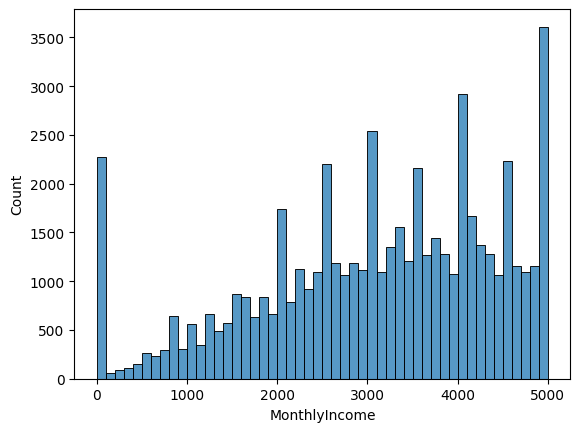

In [170]:
sns.histplot(X['MonthlyIncome'].where(X['MonthlyIncome'] <= 5000))

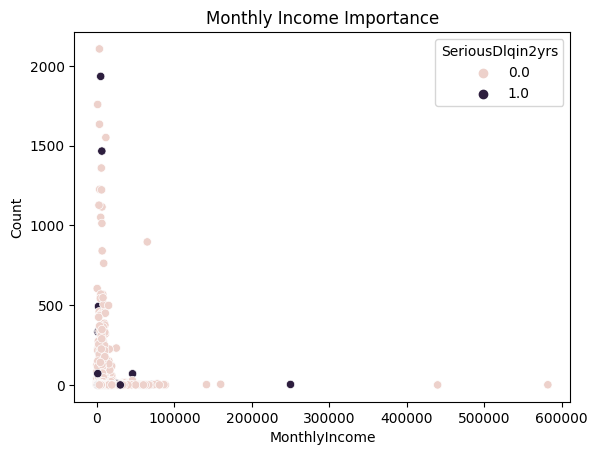

In [171]:
sns.scatterplot(data, x='MonthlyIncome', y=X['MonthlyIncome'].value_counts(), hue=y)
plt.title('Monthly Income Importance')
plt.ylabel('Count')

plt.show()

In [172]:
X['NumberOfDependents'].value_counts(normalize=True)

0.0     0.594909
1.0     0.180153
2.0     0.133643
3.0     0.064918
4.0     0.019593
5.0     0.005107
6.0     0.001082
7.0     0.000349
8.0     0.000164
10.0    0.000034
9.0     0.000034
13.0    0.000007
20.0    0.000007
Name: NumberOfDependents, dtype: float64

<Axes: xlabel='NumberOfDependents', ylabel='Count'>

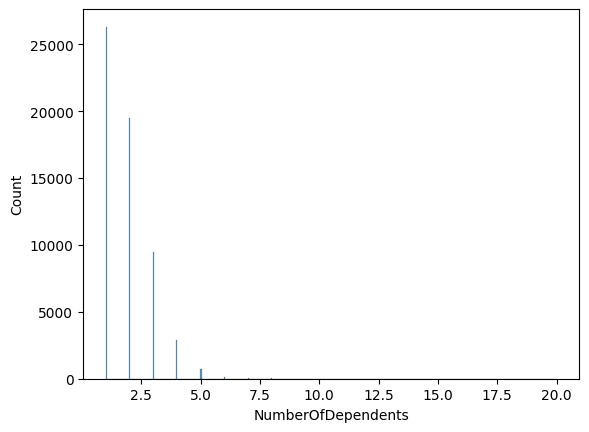

In [173]:
sns.histplot(X['NumberOfDependents'].where(X['NumberOfDependents'] > 0))

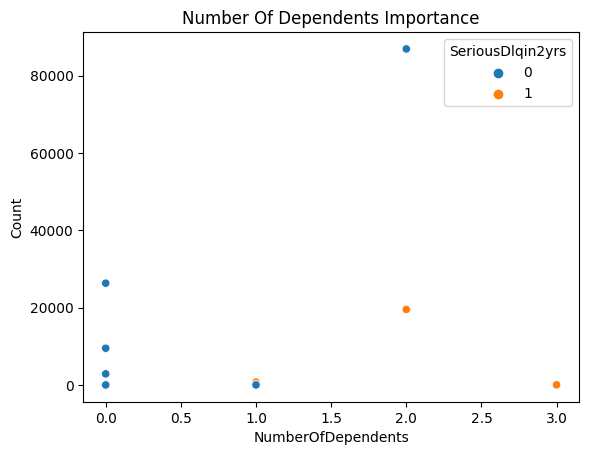

In [174]:
sns.scatterplot(data, x=X['NumberOfDependents'], y=X['NumberOfDependents'].value_counts(), hue=y)
plt.title('Number Of Dependents Importance')
plt.ylabel('Count')

plt.show()

Выбросы в числе иждивенцев не столь значимы для таргетных предсказаний сколько месячная зарплата, но всё же попробую выбросить их

In [175]:
X['MonthlyIncome'] = X['MonthlyIncome'].where(X['MonthlyIncome'] <= 5000)
X['NumberOfDependents'] = X['NumberOfDependents'].where(X['NumberOfDependents'] > 0)

Посмотрим на категориальные данные

In [176]:
X.describe(include=['object'])

,RealEstateLoansOrLines,GroupAge
count,150000,150000
unique,5,5
top,A,d
freq,140048,47268


In [177]:
X['RealEstateLoansOrLines'].value_counts()

A    140048
B      8470
C      1388
D        84
E        10
Name: RealEstateLoansOrLines, dtype: int64

In [178]:
X['GroupAge'].value_counts()

d    47268
e    42930
c    42458
b    17343
a        1
Name: GroupAge, dtype: int64

Видно, что на этапе тренировки необходимо будет сбалансировать признаки закодированного количества кредитов и закодированных возрастных групп

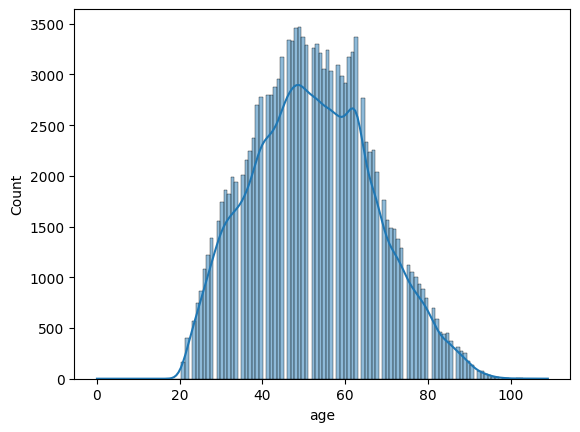

In [179]:
sns.histplot(X['age'], kde=True)
plt.show()

In [180]:
print(f"{round(X['age'].isna().sum() / X['age'].sum() * 100, 3)}% возрастных данных занимают пустые значения")

0.21% возрастных данных занимают пустые значения


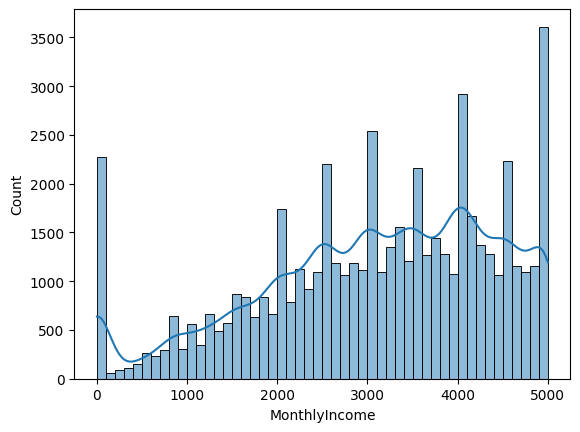

In [181]:
sns.histplot(X['MonthlyIncome'], kde=True)
plt.show()

In [182]:
print(f"{round(X['MonthlyIncome'].isna().sum() / X['MonthlyIncome'].sum() * 100, 3)}% данных по месячным доходам занимают пустые значения")

0.055% данных по месячным доходам занимают пустые значения


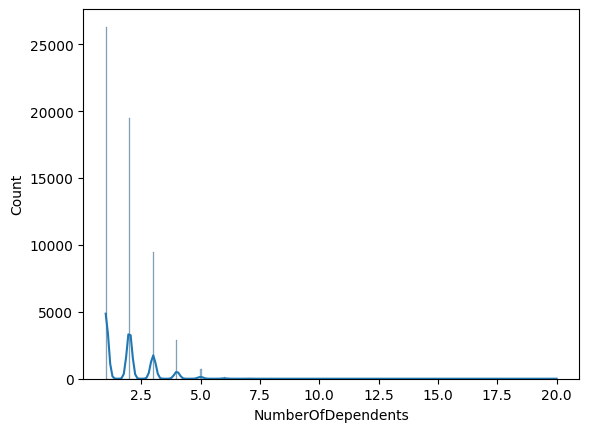

In [183]:
sns.histplot(X['NumberOfDependents'], kde=True)
plt.show()

In [184]:
print(f"{round(X['NumberOfDependents'].isna().sum() / X['NumberOfDependents'].sum() * 100, 3)}% данных по кол-ву иждивенцев занимают пустые значения")

82.112% данных по кол-ву иждивенцев занимают пустые значения


Судя по незначимости данного признака и количеству пустых значений после удаления выбросов, стоит избавиться от данного признака

In [185]:
X = X.drop(['NumberOfDependents'], axis=1)

Пустых значений довольно мало, можно заменить средним или медианой в зависимости от значимости признаков и присутствия выбросов в виде высоких месячных зарплат и большого кол-ва иждивенцев

In [186]:
mean = X['MonthlyIncome']. mean()
X['MonthlyIncome'].fillna(mean, inplace=True)

In [187]:
mean = X['age'].mean()
X['age'].fillna(mean, inplace=True)

In [188]:
print(f"{round(X['age'].isna().sum() / X['age'].sum() * 100, 3)}% возрастных данных занимают пустые значения")
print(f"{round(X['MonthlyIncome'].isna().sum() / X['MonthlyIncome'].sum() * 100, 3)}% данных по месячным доходам занимают пустые значения")

0.0% возрастных данных занимают пустые значения
0.0% данных по месячным доходам занимают пустые значения


либо это можно сделать конвейерным методом, включая категориальные столбцы, для которых применить OneHotEncoding и пустые значения заменить наиболее частыми

###Масштабирование, OneHotEncoding и создание пайплайна для категориальных и числовых признаков

In [189]:
num_data = X.drop(['RealEstateLoansOrLines', 'GroupAge'], axis=1)
num_cols = list(num_data.columns)
num_cols

['RevolvingUtilizationOfUnsecuredLines',
 'age',
 'NumberOfTime30-59DaysPastDueNotWorse',
 'DebtRatio',
 'MonthlyIncome',
 'NumberOfOpenCreditLinesAndLoans',
 'NumberOfTimes90DaysLate',
 'NumberOfTime60-89DaysPastDueNotWorse']

In [190]:
cat_data = X.loc[:, data.dtypes == np.object]
cat_cols = list(cat_data.columns)
cat_cols

['RealEstateLoansOrLines', 'GroupAge']

In [191]:
num_pipe = Pipeline(steps=[
    ('impute', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

cat_pipe = Pipeline(steps=[
    ('impute', SimpleImputer(strategy='most_frequent')),
    ('one-hot', OneHotEncoder(handle_unknown='ignore', sparse=False))
])

In [192]:
col_trans = ColumnTransformer(transformers=[
    ('num_pipe', num_pipe, num_cols),
    ('cat_pipe', cat_pipe, cat_cols),
    ],
    remainder='drop',
    n_jobs=-1)

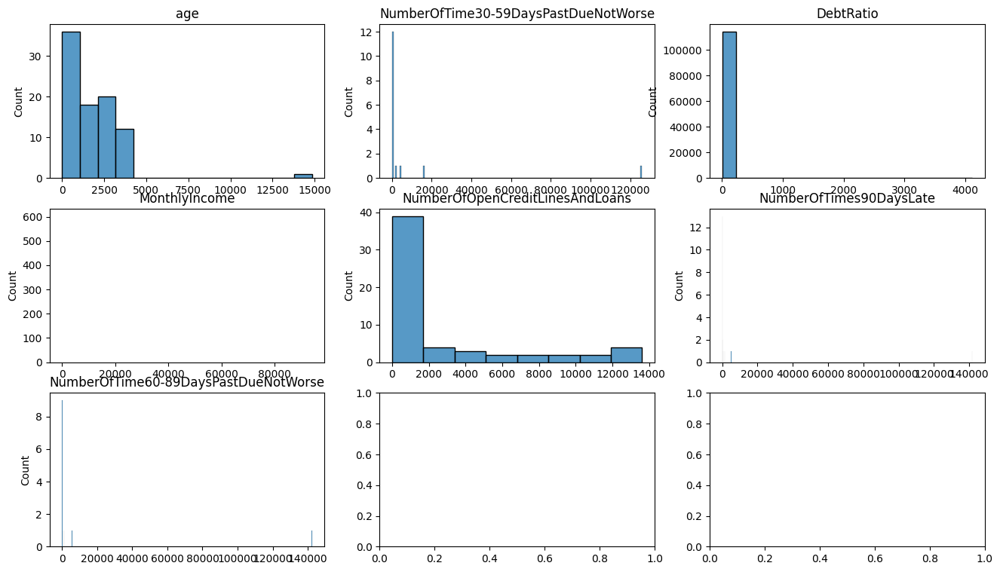

In [193]:
fig, axes = plt.subplots(3, 3, figsize=(16, 9))
idx = 1

for i in range(3):
    for j in range(3):
        if i == 3 and j == 3:
            continue
        try:
            sns.histplot(X[num_cols[idx]].value_counts().values, ax=axes[i, j]).set_title(num_cols[idx])
        except Exception as e:
            pass
        idx += 1
plt.show()

In [194]:
cat_data.sample(10)

,RealEstateLoansOrLines,GroupAge
65068,B,d
144143,A,c
102556,A,e
68910,A,d
68159,A,d
108658,A,b
94519,A,e
121575,A,c
32616,A,c
54499,A,d


In [195]:
cat_data.shape

(150000, 2)

###Распределения нормализованных признаков

In [196]:
from plotly.colors import n_colors
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [197]:
sc = StandardScaler()
X_scaled = sc.fit_transform(X[num_cols])
X_scaled = pd.DataFrame(X_scaled, columns=X[num_cols].columns)

fig = go.Figure()
columns = X_scaled.columns
colors = n_colors('rgb(5, 200, 200)', 'rgb(0, 0, 139)', X_scaled.shape[1], colortype='rgb')

for idx, color in enumerate(colors):
    if idx==0:
        continue
    fig.add_trace(go.Violin(x=X_scaled[columns[idx]]+idx/2, line_color=color, name=columns[idx], showlegend=False, hoverinfo='skip'))

fig.update_traces(orientation='h', side='positive', width=2.5, points=False)
fig.update_layout(yaxis_showgrid=False, xaxis_zeroline=False, template='ggplot2', title_text='Распределения числовых признаков', height=800)
fig.update_xaxes(showticklabels=False, title='', showgrid=False, range=[-3,23])
fig.show()


###Корреляция признаков

<Axes: >

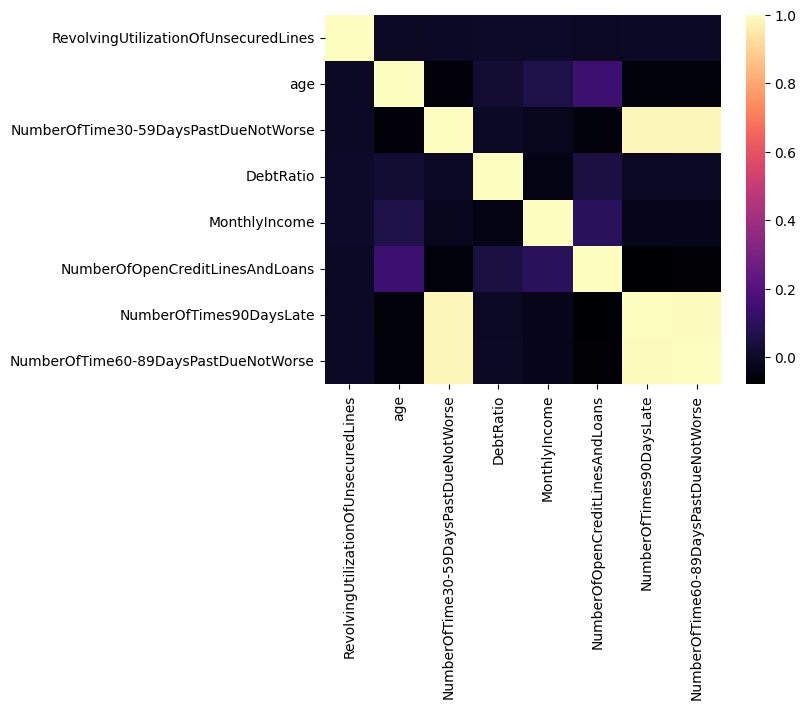

In [198]:
corr = num_data.corr()
sns.heatmap(corr, cmap="magma")

Зависимость есть

In [199]:
y.value_counts()

0    139974
1     10026
Name: SeriousDlqin2yrs, dtype: int64

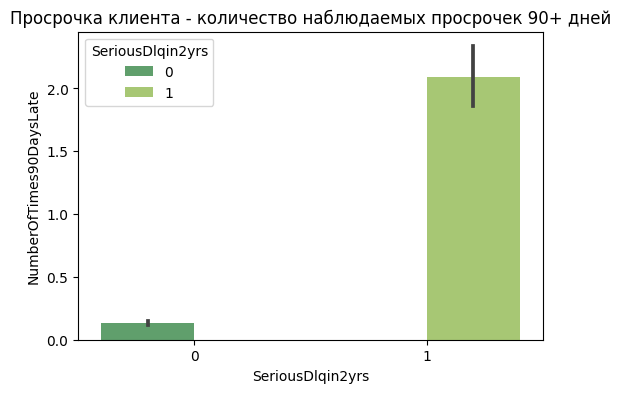

In [200]:
plt.figure(figsize=(6, 4))
sns.barplot(x='SeriousDlqin2yrs', y='NumberOfTimes90DaysLate', hue='SeriousDlqin2yrs', data=data, palette='summer')
plt.title('Просрочка клиента - количество наблюдаемых просрочек 90+ дней')
plt.show()

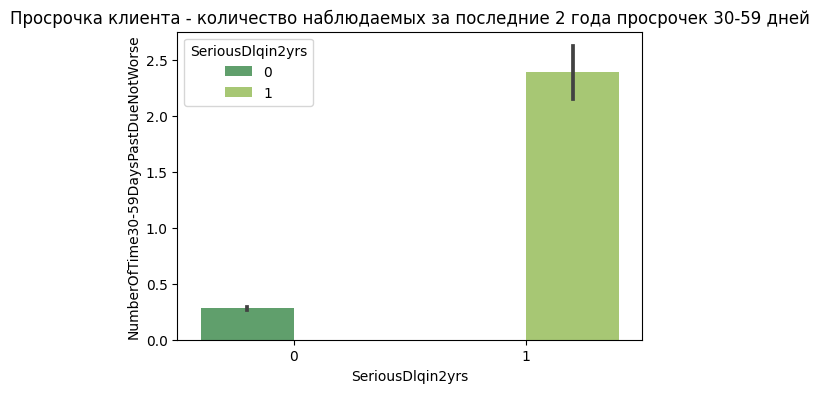

In [201]:
plt.figure(figsize=(6, 4))

sns.barplot(x='SeriousDlqin2yrs', y='NumberOfTime30-59DaysPastDueNotWorse', hue='SeriousDlqin2yrs', data=data, palette='summer')
plt.title('Просрочка клиента - количество наблюдаемых за последние 2 года просрочек 30-59 дней')
plt.show()

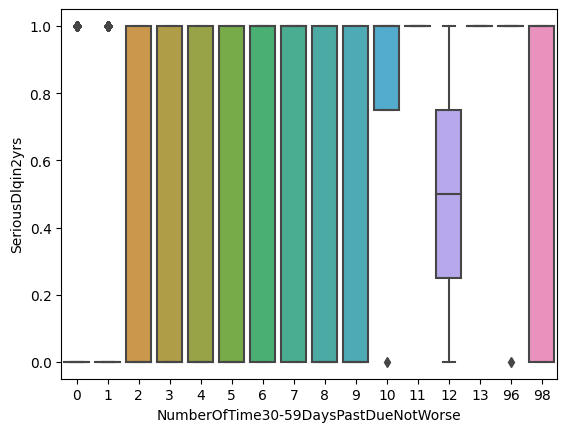

In [202]:
sns.boxplot(x="NumberOfTime30-59DaysPastDueNotWorse", y="SeriousDlqin2yrs", data=data)
plt.show()

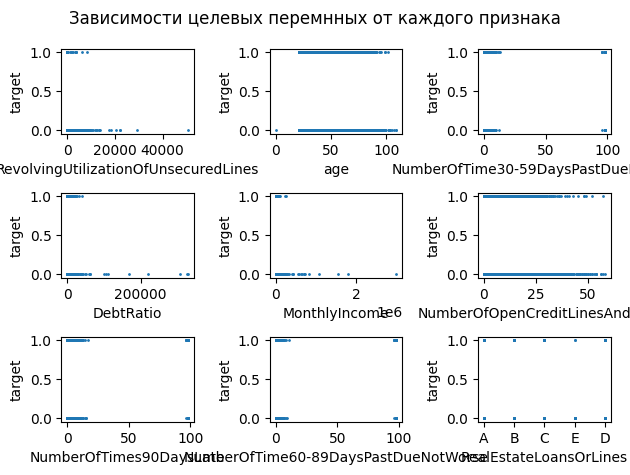

In [203]:
fig, axs = plt.subplots(3, 3)
fig.suptitle('Зависимости целевых перемнных от каждого признака')

for i in range(3):
    for j in range(3):
        n = j + i * 3
        feature = X.columns[n]
        axs[i, j].scatter(data[feature], y, s=1)
        axs[i, j].set_xlabel(feature)
        axs[i, j].set_ylabel('target')
plt.tight_layout()
plt.show()

#Кросс валидация, подбор гиперпараметров и разбиенных данных

In [204]:
from sklearn.model_selection import train_test_split


X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2,
                                                    shuffle=True,
                                                    random_state=42)

X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                  test_size=0.1,
                                                  shuffle=True,
                                                  random_state=42)

In [45]:
y_test.value_counts()

0    27962
1     2038
Name: SeriousDlqin2yrs, dtype: int64

In [205]:
def objective(trial):
    # Список гиперпараметров для перебора (для CatBoostClassifier)
    param = {
        "objective": trial.suggest_categorical("objective", ["Logloss", "CrossEntropy"]),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.1),
        "depth": trial.suggest_int("depth", 1, 8),
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", "MVS"]),
        "used_ram_limit": "3gb",
    }

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    # Определяю модель машинного обучения, которой передаются гиперпараметры
    estimator = CatBoostClassifier(**param, verbose=False)

    # Прикручиваю пайплайны
    clf_pipeline = Pipeline(steps=[
            ('col_trans', col_trans),
            ('model', estimator)
        ])
    # Код для вычисления метрики качества.
    # В этом проекте я вычисляю Accuracy методом кросс-валидации
    accuracy = cross_val_score(clf_pipeline, X_train, y_train, cv=3, scoring= 'accuracy').mean()
    return accuracy

In [48]:
import optuna


# Инициализация подбора гиперпараметров
study = optuna.create_study(direction="maximize", study_name="EDA")

# Запуск процесса подбора гиперпараметров
study.optimize(objective, n_trials=50)

# Лучший результат
print(study.best_trial)

[I 2023-06-28 07:38:33,849] A new study created in memory with name: EDA
[I 2023-06-28 07:41:12,281] Trial 0 finished with value: 0.9371407407407407 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0310860251812798, 'depth': 6, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS'}. Best is trial 0 with value: 0.9371407407407407.
[I 2023-06-28 07:41:51,291] Trial 1 finished with value: 0.9372888888888888 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07952853356432987, 'depth': 2, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.8763886609225}. Best is trial 1 with value: 0.9372888888888888.
[I 2023-06-28 07:45:07,284] Trial 2 finished with value: 0.9376666666666668 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.09874495497899863, 'depth': 6, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS'}. Best is trial 2 with value: 0.9376666666666668.
[I 2023-06-28 07:47:42,595] Trial 3 finished with value: 0.93643703703

FrozenTrial(number=42, state=TrialState.COMPLETE, values=[0.9377185185185185], datetime_start=datetime.datetime(2023, 6, 28, 8, 48, 24, 884341), datetime_complete=datetime.datetime(2023, 6, 28, 8, 51, 37, 536189), params={'objective': 'CrossEntropy', 'colsample_bylevel': 0.09457461592841351, 'depth': 7, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9697893373143822}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'objective': CategoricalDistribution(choices=('Logloss', 'CrossEntropy')), 'colsample_bylevel': FloatDistribution(high=0.1, log=False, low=0.01, step=None), 'depth': IntDistribution(high=8, log=False, low=1, step=1), 'boosting_type': CategoricalDistribution(choices=('Ordered', 'Plain')), 'bootstrap_type': CategoricalDistribution(choices=('Bayesian', 'Bernoulli', 'MVS')), 'subsample': FloatDistribution(high=1.0, log=False, low=0.1, step=None)}, trial_id=42, value=None)


Самые оптимальные значения для модели CatBoostClassifier за 50 эпох:

In [49]:
study.best_params

{'objective': 'CrossEntropy',
 'colsample_bylevel': 0.09457461592841351,
 'depth': 7,
 'boosting_type': 'Ordered',
 'bootstrap_type': 'Bernoulli',
 'subsample': 0.9697893373143822}

In [52]:
study.best_value

0.9377185185185185

In [51]:
study.best_trial

FrozenTrial(number=42, state=TrialState.COMPLETE, values=[0.9377185185185185], datetime_start=datetime.datetime(2023, 6, 28, 8, 48, 24, 884341), datetime_complete=datetime.datetime(2023, 6, 28, 8, 51, 37, 536189), params={'objective': 'CrossEntropy', 'colsample_bylevel': 0.09457461592841351, 'depth': 7, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9697893373143822}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'objective': CategoricalDistribution(choices=('Logloss', 'CrossEntropy')), 'colsample_bylevel': FloatDistribution(high=0.1, log=False, low=0.01, step=None), 'depth': IntDistribution(high=8, log=False, low=1, step=1), 'boosting_type': CategoricalDistribution(choices=('Ordered', 'Plain')), 'bootstrap_type': CategoricalDistribution(choices=('Bayesian', 'Bernoulli', 'MVS')), 'subsample': FloatDistribution(high=1.0, log=False, low=0.1, step=None)}, trial_id=42, value=None)

###Важность гиперпараметров

In [106]:
optuna.visualization.plot_param_importances(study)

Видно, что самым важным параметром является 'colsample_bylevel' -  процент признаков, используемых при каждом сплите, когда признаки снова выбираются случайным образом, на 2 месте 'depth' - глубина дерева и т.д.

In [222]:
optuna.visualization.plot_slice(study)

Контурный график, который показывает важность всех выбранных гиперпараметров для CatBoostClassifier'а

In [223]:
optuna.visualization.plot_contour(study)

#Обучение модели

In [206]:
clf = CatBoostClassifier(iterations=500,
                         depth=7,
                         objective='CrossEntropy',
                         colsample_bylevel=0.09457461592841351,
                         boosting_type='Ordered',
                         bootstrap_type='Bernoulli',
                         subsample=0.9697893373143822)

clf.fit(X_train, y_train,
        cat_features=cat_cols,
        eval_set=(X_val, y_val),
        verbose=False,
        plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#Предсказание таргетов

In [207]:
clf_pipe = Pipeline(steps=[
    ('col_trans', col_trans),
    ('model', clf)])

clf_pipe.fit(X_train, y_train)
y_pred = clf_pipe.predict(X_test)

0:	learn: 0.6491960	total: 134ms	remaining: 1m 6s
1:	learn: 0.6187583	total: 211ms	remaining: 52.5s
2:	learn: 0.5876971	total: 303ms	remaining: 50.1s
3:	learn: 0.5558372	total: 406ms	remaining: 50.3s
4:	learn: 0.5264740	total: 518ms	remaining: 51.3s
5:	learn: 0.4974321	total: 644ms	remaining: 53s
6:	learn: 0.4779475	total: 736ms	remaining: 51.8s
7:	learn: 0.4599508	total: 826ms	remaining: 50.8s
8:	learn: 0.4433396	total: 907ms	remaining: 49.5s
9:	learn: 0.4251385	total: 1s	remaining: 49.1s
10:	learn: 0.4050921	total: 1.14s	remaining: 50.6s
11:	learn: 0.3896965	total: 1.24s	remaining: 50.4s
12:	learn: 0.3752447	total: 1.34s	remaining: 50.4s
13:	learn: 0.3595724	total: 1.45s	remaining: 50.5s
14:	learn: 0.3500246	total: 1.55s	remaining: 50.1s
15:	learn: 0.3376023	total: 1.68s	remaining: 50.7s
16:	learn: 0.3277373	total: 1.77s	remaining: 50.4s
17:	learn: 0.3182108	total: 1.9s	remaining: 51s
18:	learn: 0.3085356	total: 2.02s	remaining: 51.2s
19:	learn: 0.2987569	total: 2.14s	remaining: 51.3

In [208]:
print(clf_pipe)

Pipeline(steps=[('col_trans',
                 ColumnTransformer(n_jobs=-1,
                                   transformers=[('num_pipe',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['RevolvingUtilizationOfUnsecuredLines',
                                                   'age',
                                                   'NumberOfTime30-59DaysPastDueNotWorse',
                                                   'DebtRatio', 'MonthlyIncome',
                                                   'NumberOfOpenCreditLinesAndLoans',
                                                   'NumberOfTimes90DaysLate',
                                 

In [209]:
preds = pd.Series(y_test).astype(bool)
submission = pd.concat([y_test, preds], axis=1)
submission.head()

,SeriousDlqin2yrs,SeriousDlqin2yrs
59770,0,False
21362,0,False
127324,0,False
140509,0,False
144297,0,False


In [211]:
submission.describe()

,SeriousDlqin2yrs
count,30000.000000
mean,0.067933
std,0.251636
min,0.000000
25%,0.000000
50%,0.000000
75%,0.000000
max,1.000000


In [217]:
import pickle


with open('model.pickle', 'wb') as f:
    pickle.dump(clf, f)
with open('model_pipe.pickle', 'wb') as f:
    pickle.dump(clf_pipe, f)

In [218]:
# а так модель можно загрузить из файла:
# with open('filename.pickle', 'rb') as f:
#     model = pickle.load(f)

In [258]:
!git config --global user.name 'Vladislav-GitHub'
!git config --global user.email vladislav.gabidullin1@gmail.com

In [259]:
!git config --list

filter.lfs.smudge=git-lfs smudge -- %f
filter.lfs.process=git-lfs filter-process
filter.lfs.required=true
filter.lfs.clean=git-lfs clean -- %f
user.name=Vladislav-GitHub
user.email=vladislav.gabidullin1@gmail.com
core.repositoryformatversion=0
core.filemode=true
core.bare=false
core.logallrefupdates=true
remote.origin.url=git@github.com:Vladislav-GitHub/Credit-Scoring_HSE_Bootcamp.git
remote.origin.fetch=+refs/heads/*:refs/remotes/origin/*


In [ ]:
!git init

In [ ]:
!git remote add origin git@github.com:Vladislav-GitHub/Credit-Scoring_HSE_Bootcamp.git

In [ ]:
!git status

In [268]:
!git add .

In [ ]:
!git status

In [ ]:
!git commit -m 'Создание проекта'

In [270]:
!git push -u -f origin main

error: src refspec main does not match any
error: failed to push some refs to 'git@github.com:Vladislav-GitHub/Credit-Scoring_HSE_Bootcamp.git'


In [271]:
!git show-ref

17d558f18492128509fb4b866f9fd1afb55551ed refs/heads/master


In [ ]:
!git push origin HEAD:main